In [12]:
# !pip install numpy==1.26.4

In [1]:
from dl4to.problem import Problem
import torch

In [2]:
import torch
from dl4to.problem import Problem

E = 2e11  # Young's modulus (Pa)
ν = 0.3   # Poisson's ratio
σ_ys = 2.5e8  # Yield stress (Pa)

# Beam dimensions
shape = [32, 10, 10]  # [x, y, z]
h = [0.01, 0.01, 0.01]  # voxel size in meters

# Force tensor
F = torch.zeros(3, *shape)

# Apply downward force on the bottom layer of the rightmost face (x = -1, y = 0)
F[-1, -1, 0, :] = -1e7  # full width (z-direction) of the bottom row

# Dirichlet boundary conditions (fix all voxels on left face x = 0)
Ω_dirichlet = torch.zeros(3, *shape)
Ω_dirichlet[:, 0, :, :] = 1

# Design space: allow everything except fixed face and force-applied voxels to be optimized
Ω_design = -torch.ones(1, *shape)
Ω_design[:, 0, :, :] = 1  # keep material on the fixed side
Ω_design[:, -1, 0, :] = 1  # keep material where the force is applied

# Create the problem
problem = Problem(E, ν, σ_ys, h, Ω_dirichlet, Ω_design, F, restrict_density_for_voxels_with_applied_forces=False)


In [50]:
camera_position = (0, 0.35, 0.2)
problem.plot(camera_position=camera_position,
             show_axislabels=True,
             show_ticklabels=True,
             display=True)

In [51]:
from dl4to.criteria import Compliance, VolumeConstraint
from dl4to.topo_solvers import SIMP
from dl4to.pde import FDM
criterion = Compliance() + VolumeConstraint(max_volume_fraction=.12, threshold_fct='relu')

simp = SIMP(
    criterion=criterion,
    binarizer_steepening_factor=1.02,
    n_iterations=60,
    lr=4e-1,
)
problem.pde_solver = FDM(padding_depth=0)
solution = simp(problem)

100%|██████████| 60/60 [00:29<00:00,  2.05it/s]


In [52]:
solution.plot(camera_position=camera_position,
              display=True)

In [ ]:
# import pickle
# with open(f"problem_1.pkl", "wb") as f:
#         pickle.dump(problem, f)

# with open(f"solution_1.pkl", "wb") as f:
#     pickle.dump(solution, f)

In [ ]:
import torch
import random
import pickle
from dl4to.problem import Problem
from dl4to.criteria import Compliance, VolumeConstraint
from dl4to.topo_solvers import SIMP
from dl4to.pde import FDM

# Material properties
E = 2e11  # Young's modulus (Pa)
ν = 0.3   # Poisson's ratio
σ_ys = 2.5e8  # Yield stress (Pa)

# Define beam dimensions
shape = [32, 10, 10]  # 60 voxels in x, 10 in y, 10 in z
h = [0.01, 0.01, 0.01]  # Each voxel is 1 cm³

# Optimization settings
criterion = Compliance() + VolumeConstraint(max_volume_fraction=.12, threshold_fct='relu')
simp = SIMP(criterion=criterion, binarizer_steepening_factor=1.02, n_iterations=100, lr=4e-1)

# Faces for boundary conditions
faces = {
    "x0": (0, "x"), "x1": (-1, "x"),
    "y0": (0, "y"), "y1": (-1, "y"),
    "z0": (0, "z"), "z1": (-1, "z")
}

# Number of problems to generate
num_problems = 10  # Adjust as needed

for i in range(1,num_problems):
    # Select random faces for Dirichlet and force application (ensuring they are not the same)
    fixed_face_key, force_face_key = random.sample(list(faces.keys()), 2)
    
    fixed_index, fixed_axis = faces[fixed_face_key]
    force_index, force_axis = faces[force_face_key]

    # Initialize force tensor
    F = torch.zeros(3, *shape)

    # Compute center indices for y and z (or other axes if force is applied there)
    center_y = shape[1] // 2
    center_z = shape[2] // 2

    # Apply force at the center of the selected face
    if force_axis == "x":
        F[-1, force_index, center_y-1:center_y+1, center_z-1:center_z+1] = -1e7
    elif force_axis == "y":
        F[-2, :, force_index, center_z-1:center_z+1] = -1e7
    elif force_axis == "z":
        F[-3, :, center_y-1:center_y+1, force_index] = -1e7

    # Initialize Dirichlet boundary conditions
    Ω_dirichlet = torch.zeros(3, *shape)
    if fixed_axis == "x":
        Ω_dirichlet[:, fixed_index, :, :] = 1
    elif fixed_axis == "y":
        Ω_dirichlet[:, :, fixed_index, :] = 1
    elif fixed_axis == "z":
        Ω_dirichlet[:, :, :, fixed_index] = 1

    # Initialize design space
    Ω_design = -torch.ones(1, *shape)
    Ω_design += Ω_dirichlet[0:1]  # Ensure material at fixed boundary
    Ω_design += (F.abs().sum(dim=0, keepdim=True) > 0).float()  # Ensure material at force application region

    # Create the problem
    problem = Problem(E, ν, σ_ys, h, Ω_dirichlet, Ω_design, F, restrict_density_for_voxels_with_applied_forces=False)
    problem.pde_solver = FDM(padding_depth=0)

    # Solve the problem
    solution = simp(problem)

    # Save problem and solution
    with open(f"problem_{i}.pkl", "wb") as f:
        pickle.dump(problem, f)

    with open(f"solution_{i}.pkl", "wb") as f:
        pickle.dump(solution, f)

    print(f"Saved problem_{i}.pkl and solution_{i}.pkl")



 63%|██████▎   | 38/60 [00:17<00:10,  2.14it/s]


KeyboardInterrupt: 

In [87]:
import torch
import random
import pickle
from dl4to.problem import Problem
from dl4to.criteria import Compliance, VolumeConstraint
from dl4to.topo_solvers import SIMP
from dl4to.pde import FDM

# Material properties
E = 2e11  # Young's modulus (Pa)
ν = 0.3   # Poisson's ratio
σ_ys = 2.5e8  # Yield stress (Pa)

# Define beam dimensions
shape = [30, 10, 10]  # 60 voxels in x, 10 in y, 10 in z
h = [0.01, 0.01, 0.01]  # Each voxel is 1 cm³

# Optimization settings
criterion = Compliance() + VolumeConstraint(max_volume_fraction=.12, threshold_fct='relu')
simp = SIMP(criterion=criterion, binarizer_steepening_factor=1.02, n_iterations=100, lr=4e-1)

# Surface faces for boundary conditions
faces = {
    "x0": (0, "x", 0),    # Left face (x=0)
    "x1": (-1, "x", 0),   # Right face (x=max)
    "y0": (0, "y", 1),    # Bottom face (y=0)
    "y1": (-1, "y", 1),   # Top face (y=max)
    "z0": (0, "z", 2),    # Front face (z=0)
    "z1": (-1, "z", 2)    # Back face (z=max)
}

# Number of problems to generate
num_problems = 5  # Adjust as needed
problems_saved = 0

while problems_saved < num_problems:
    try:
        # Select random faces for Dirichlet and force application
        if random.random() < 0.7:  # 70% chance to use x0 as fixed face (cantilever-like setup)
            fixed_face_key = "x0"
            # Avoid using the same face for force application
            force_face_candidates = [key for key in faces.keys() if key != fixed_face_key]
            force_face_key = random.choice(force_face_candidates)
        else:
            # Random selection ensuring different faces
            face_keys = list(faces.keys())
            fixed_face_key = random.choice(face_keys)
            force_face_candidates = [key for key in face_keys if key != fixed_face_key]
            force_face_key = random.choice(force_face_candidates)
        
        fixed_index, fixed_axis, fixed_dim = faces[fixed_face_key]
        force_index, force_axis, force_dim = faces[force_face_key]
        
        # Initialize force tensor (3D, directions x, y, z)
        F = torch.zeros(3, *shape)
        
        # Calculate center regions for force application on the surface
        center_x = shape[0] // 2
        center_y = shape[1] // 2
        center_z = shape[2] // 2
        
        # Apply force only on the surface in the appropriate direction
        # Force magnitude should be perpendicular to the surface
        force_magnitude = -1e7  # Negative for compressive force
        
        if force_axis == "x":  # Force on x-face
            # Determine the direction (inward to the structure)
            direction = 0  # Force in x-direction
            if force_index == 0:  # Left face
                force_direction = 1  # Positive x-direction (pushing right)
            else:  # Right face
                force_direction = -1  # Negative x-direction (pushing left)
                
            # Apply force to a patch on the x-face
            patch_y, patch_z = 2, 2  # Size of force application patch
            F[direction, force_index, 
              center_y-patch_y:center_y+patch_y, 
              center_z-patch_z:center_z+patch_z] = force_magnitude * force_direction
            
        elif force_axis == "y":  # Force on y-face
            direction = 1  # Force in y-direction
            if force_index == 0:  # Bottom face
                force_direction = 1  # Positive y-direction (pushing up)
            else:  # Top face
                force_direction = -1  # Negative y-direction (pushing down)
                
            # Apply force to a patch on the y-face
            patch_x, patch_z = 2, 2
            F[direction, 
              center_x-patch_x:center_x+patch_x, 
              force_index, 
              center_z-patch_z:center_z+patch_z] = force_magnitude * force_direction
            
        elif force_axis == "z":  # Force on z-face
            direction = 2  # Force in z-direction
            if force_index == 0:  # Front face
                force_direction = 1  # Positive z-direction (pushing back)
            else:  # Back face
                force_direction = -1  # Negative z-direction (pushing front)
                
            # Apply force to a patch on the z-face
            patch_x, patch_y = 2, 2
            F[direction, 
              center_x-patch_x:center_x+patch_x, 
              center_y-patch_y:center_y+patch_y, 
              force_index] = force_magnitude * force_direction
        
        # Initialize Dirichlet boundary conditions (fixed points)
        Ω_dirichlet = torch.zeros(3, *shape)
        
        # Apply Dirichlet boundary conditions only on the surface
        if fixed_axis == "x":
            Ω_dirichlet[:, fixed_index, :, :] = 1
        elif fixed_axis == "y":
            Ω_dirichlet[:, :, fixed_index, :] = 1
        elif fixed_axis == "z":
            Ω_dirichlet[:, :, :, fixed_index] = 1
        
        # Initialize design space
        Ω_design = -torch.ones(1, *shape)
        # Ensure material at fixed boundary
        Ω_design += Ω_dirichlet[0:1]
        # Ensure material at force application region
        Ω_design += (F.abs().sum(dim=0, keepdim=True) > 0).float()
        
        # Create the problem
        problem = Problem(E, ν, σ_ys, h, Ω_dirichlet, Ω_design, F, restrict_density_for_voxels_with_applied_forces=False)
        problem.pde_solver = FDM(padding_depth=0)
        
        # Solve the problem
        solution = simp(problem)
        
        # Check if solution exists and has valid values
        if solution is not None and hasattr(solution, 'θ'):
            # Extract density for validation
            density = solution.θ if hasattr(solution, 'θ') else getattr(solution, 'x', None)
            
            if density is not None and torch.isfinite(density).all() and not torch.all(density == 0):
                # Save problem and solution
                with open(f"problem_{problems_saved}.pkl", "wb") as f:
                    pickle.dump(problem, f)
                
                with open(f"solution_{problems_saved}.pkl", "wb") as f:
                    pickle.dump(solution, f)
                    
                print(f"Saved problem_{problems_saved}.pkl and solution_{problems_saved}.pkl")
                print(f"Configuration: Fixed at {fixed_face_key}, Force on {force_face_key}")
                problems_saved += 1
            else:
                print(f"Skipping invalid solution (density issues) for Fixed: {fixed_face_key}, Force: {force_face_key}")
        else:
            print(f"Skipping invalid solution (None or missing density) for Fixed: {fixed_face_key}, Force: {force_face_key}")
            
    except Exception as e:
        print(f"Error in problem generation/solution: {str(e)}")
        print(f"Skipping problematic configuration: Fixed at {fixed_face_key}, Force on {force_face_key}")

print(f"Successfully generated {problems_saved} valid problems and solutions")

100%|██████████| 100/100 [00:50<00:00,  1.99it/s]


Skipping invalid solution (density issues) for Fixed: x1, Force: y0


100%|██████████| 100/100 [00:44<00:00,  2.24it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: x1


100%|██████████| 100/100 [00:45<00:00,  2.18it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: z0


100%|██████████| 100/100 [00:48<00:00,  2.08it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: z1


100%|██████████| 100/100 [00:46<00:00,  2.16it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: y0


100%|██████████| 100/100 [00:48<00:00,  2.06it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: z0


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: x1


100%|██████████| 100/100 [00:42<00:00,  2.33it/s]


Skipping invalid solution (density issues) for Fixed: y0, Force: z1


100%|██████████| 100/100 [00:38<00:00,  2.60it/s]


Skipping invalid solution (density issues) for Fixed: y1, Force: x0


100%|██████████| 100/100 [00:48<00:00,  2.08it/s]


Skipping invalid solution (density issues) for Fixed: x0, Force: z1


 40%|████      | 40/100 [00:15<00:22,  2.65it/s]


KeyboardInterrupt: 

In [80]:

# Load problem
with open("/Users/0x4ry4n/Desktop/dev/problems-sol/problem_4.pkl", "rb") as f:
    problem = pickle.load(f)

# Load solution
with open("/Users/0x4ry4n/Desktop/dev/problems-sol/solution_0.pkl", "rb") as f:
    solution = pickle.load(f)

# Now you can access problem and solution attributes
# print("Loaded problem shape:", problem.shape)
# print("Loaded solution density shape:", solution.rho.shape)


In [59]:
camera_position = (0, 0.35, 0.2)
problem.plot(camera_position=camera_position,
             show_axislabels=True,
             show_ticklabels=True,
             display=True)

In [81]:
solution.plot(camera_position=camera_position,
              display=True)

In [4]:
from dl4to.datasets import SELTODataset

dataset = SELTODataset(root='./dl4to_dataset/', 
                       name='disc_simple', 
                       train=True)

Found 0 files.
Done!
Extracting disc_simple_train...
Done!
Generating dataset...


100%|██████████| 1509/1509 [00:12<00:00, 117.17it/s]


done!
pt dataset generated in directory `./dl4to_dataset//disc_simple/train`.
Found 1509 files.
importing dataset...


100%|██████████| 1509/1509 [00:01<00:00, 1078.54it/s]

done!


In [3]:
len(dataset)

1509

In [18]:
problem, solution = dataset[300]

In [5]:
camera_position = (0, 0.06, 0.12)
problem.plot(camera_position=camera_position,
             display=True)

In [6]:
solution.plot(camera_position=camera_position,
              display=True)

In [4]:
dataset_val = SELTODataset("./dl4to_dataset", name="disc_simple", train=False)

Found 200 files.
importing dataset...


100%|██████████| 200/200 [00:00<00:00, 845.29it/s]

done!


In [5]:
from dl4to.utils import get_dataloader

dataloader_train = get_dataloader(dataset, batch_size=128)
dataloader_val = get_dataloader(dataset_val, batch_size=1)

In [6]:
from dl4to.preprocessing import TrivialPreprocessing
preprocessing = TrivialPreprocessing(normalize=True, dataset=dataset)

In [7]:
# model = torch.nn.Sequential(
#     torch.nn.Conv3d(in_channels=preprocessing.shape, 
#                         out_channels=1, 
#                         kernel_size=3, 
#                         padding=1),
#     torch.nn.Sigmoid()
# )

In [11]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class UNetCUstome(nn.Module):
    def __init__(
        self,
        in_channels: int=7,  # Number of input channels
        out_channels: int=1,  # Number of output channels
        base_channels: int=28,  # Number of channels in the first layer
        num_blocks: int=4,  # Number of encoding/decoding blocks
        dimensions: int = 3,  # Spatial dimensions (2D or 3D)
        normalization: str = "batch",  # Normalization type ("batch", "layer", or "instance")
        activation: str = "ReLU",  # Activation function
        pooling_type: str = "max",  # Pooling type ("max" or "avg")
        upsampling_type: str = "nearest",  # Upsampling type ("nearest", "bilinear", etc.)
        residual: bool = False,  # Use residual connections
        use_padding: bool = True,  # Use padding in convolutions
        dropout: float = 0.0,  # Dropout rate
    ):
        super().__init__()
        self.num_blocks = num_blocks
        self.encoder_blocks = nn.ModuleList()
        self.decoder_blocks = nn.ModuleList()
        self.pooling = self._get_pooling_layer(pooling_type, dimensions)
        self.upsampling_type = upsampling_type
        self.sigmoid = nn.Sigmoid()

        # Build Encoder
        for i in range(num_blocks):
            in_ch = in_channels if i == 0 else base_channels * 2 ** (i - 1)
            out_ch = base_channels * 2 ** i
            self.encoder_blocks.append(self._create_block(in_ch, out_ch, dimensions, normalization, activation, use_padding, dropout, residual))

        # Build Bottleneck
        self.bottleneck = self._create_block(base_channels * 2 ** (num_blocks - 1), base_channels * 2 ** num_blocks, dimensions, normalization, activation, use_padding, dropout, residual)

        # Build Decoder
        for i in range(num_blocks):
            in_ch = base_channels * 2 ** (num_blocks - i)
            out_ch = base_channels * 2 ** (num_blocks - i - 1)
            self.decoder_blocks.append(self._create_block(in_ch, out_ch, dimensions, normalization, activation, use_padding, dropout, residual))
            self.decoder_blocks.append(self._get_upsampling_layer(upsampling_type, dimensions, out_ch, out_ch))

        # Final Output Convolution
        self.final_conv = nn.Conv2d(base_channels, out_channels, kernel_size=1) if dimensions == 2 else nn.Conv3d(base_channels, out_channels, kernel_size=1)

    def _create_block(self, in_channels, out_channels, dimensions, normalization, activation, use_padding, dropout, residual):
        layers = []

        # Convolution
        conv_class = getattr(nn, f"Conv{dimensions}d")
        padding = 1 if use_padding else 0
        layers.append(conv_class(in_channels, out_channels, kernel_size=3, padding=padding))

        # Normalization
        if normalization:
            norm_class = getattr(nn, f"{normalization.capitalize()}Norm{dimensions}d")
            layers.append(norm_class(out_channels))

        # Activation
        act_class = getattr(nn, activation)
        layers.append(act_class())

        # Dropout
        if dropout > 0:
            dropout_class = getattr(nn, f"Dropout{dimensions}d")
            layers.append(dropout_class(p=dropout))

        return nn.Sequential(*layers)

    def _get_pooling_layer(self, pooling_type, dimensions):
        pool_class = getattr(nn, f"{pooling_type.capitalize()}Pool{dimensions}d")
        return pool_class(kernel_size=2)

    def _get_upsampling_layer(self, upsampling_type, dimensions, in_channels, out_channels):
        if upsampling_type == "conv":
            conv_class = getattr(nn, f"ConvTranspose{dimensions}d")
            return conv_class(in_channels, out_channels, kernel_size=2, stride=2)
        else:
            return nn.Upsample(scale_factor=2, mode=upsampling_type)

    def forward(self, x):
        skip_connections = []

        # Encoder
        for block in self.encoder_blocks:
            x = block(x)
            skip_connections.append(x)
            x = self.pooling(x)

        # Bottleneck
        x = self.bottleneck(x)

        # Decoder
        for i in range(self.num_blocks):
            skip_connection = skip_connections.pop()
            x = self.decoder_blocks[2 * i + 1](x)  # Upsample
            x = F.pad(x, self._calculate_padding(skip_connection, x))
            x = torch.cat([skip_connection, x], dim=1)
            x = self.decoder_blocks[2 * i](x)  # Convolution

        # Final Convolution
        x = self.final_conv(x)
        return self.sigmoid(x)

    def _calculate_padding(self, skip_connection, x):
        diff = skip_connection.shape[2:] - x.shape[2:]
        padding = [item for sublist in zip(diff // 2, diff - diff // 2) for item in sublist]
        return padding[::-1]


In [12]:
model = UNetCUstome()

In [13]:
model

UNetCUstome(
  (encoder_blocks): ModuleList(
    (0): Sequential(
      (0): Conv3d(7, 28, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(28, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): Conv3d(28, 56, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): Conv3d(56, 112, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (3): Sequential(
      (0): Conv3d(112, 224, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
  )
  (decoder_blocks): ModuleList(
    (0): Sequential(
      

In [20]:
from dl4to.models import UNet3D
m = UNet3D(in_channels=preprocessing.shape, pooling_kernel_size=[2,2,1])
# m(preprocessed_problem).shape

Built model with 1596361 parameters.


In [8]:
mod = torch.load('/Users/0x4ry4n/Downloads/best_solver.pt').model

In [23]:
mod

UNet3D(
  (encoder): Encoder(
    (encoding_blocks): ModuleList(
      (0): EncodingBlock(
        (conv1): ConvolutionalBlock(
          (conv_layer): Conv3d(7, 10, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
          (activation_layer): ReLU()
          (block): Sequential(
            (0): Conv3d(7, 10, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
            (1): ReLU()
          )
        )
        (conv2): ConvolutionalBlock(
          (conv_layer): Conv3d(10, 20, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
          (norm_layer): BatchNorm3d(20, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (activation_layer): ReLU()
          (block): Sequential(
            (0): Conv3d(10, 20, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
            (1): BatchNorm3d(20, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU()
          )
        )
  

In [14]:
from dl4to.criteria import WeightedBCE

criterion = WeightedBCE()
criterion.set_optimal_weight(dataset)

Setting criterion weight to 0.852246880531311.


In [15]:
from dl4to.topo_solvers import TrainableTopoSolver
from torch.optim import Adam

optimizer = Adam(model.parameters(), lr=1e-3)

topo_solver = TrainableTopoSolver(criterion=criterion,
                                  model=model,
                                  optimizer=optimizer,
                                  preprocessing=preprocessing)

In [19]:
preprocessed_problem = preprocessing(problem)
preprocessed_problem.shape

torch.Size([1, 7, 39, 39, 4])

In [20]:
model(preprocessed_problem).shape

RuntimeError: Given input size: (112x9x9x1). Calculated output size: (112x4x4x0). Output size is too small

Train epoch: 0. Train loss: 0.43±0.12.
Valid epoch: 0. Valid loss: 0.31±0.018.
Train epoch: 9. Train loss: 0.29±0.018.
Valid epoch: 9. Valid loss: 0.29±0.02.


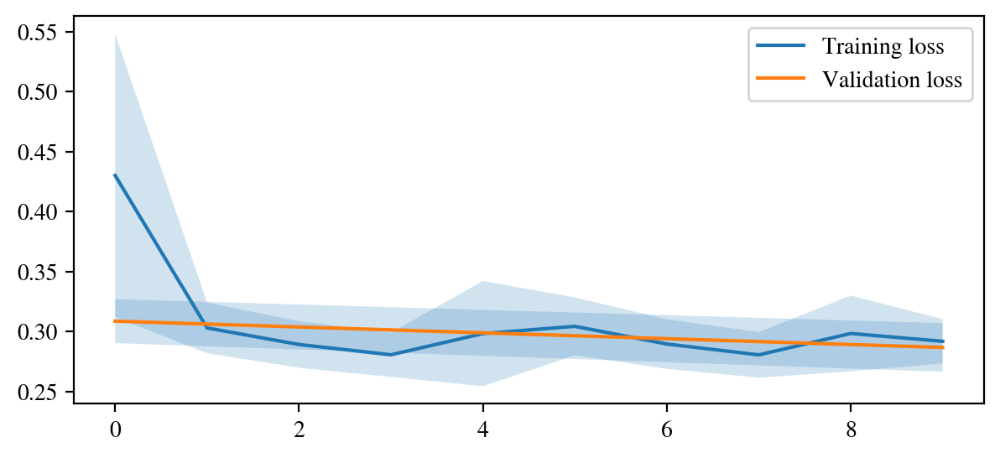

Finished training after 10 epochs.



In [76]:
topo_solver.train(
        root='./training/cnn',
        epochs=10,
        dataloader_train=dataloader_train,
        dataloader_val=dataloader_val,
        validation_interval=10
)

In [28]:
from dl4to.criteria import IoU, Dice

criteria = [IoU(), Dice()]

logs = topo_solver.eval(
        root='training/cnn',
        criteria=criteria,
        dataloader=dataloader_val,
    )

In [29]:
print("IoU:", sum(logs['IoU']) / len(logs['IoU']))
print("Dice:", sum(logs['Dice']) / len(logs['Dice']))

IoU: 0.8347633334994317
Dice: 0.09156799256801605


In [17]:
solution = topo_solver(problem)
camera_position = [0,0.02,0.12]
solution.plot(threshold=.5, 
              camera_position=camera_position,
              display=True)